Datalakes Parse Parameters 
The table below maps the physical parameter to its given axis. 
 
Axis | Parameter | NetCDF Parameter Name | Unit | Description 
x | Time | time | seconds since 1970-01-01 00:00:00 | Time 
y | Depth | pressure | m | Depth is the vertical distance below the surface. 
z1 | Conductivity | conductivity | mS/cm | Electrical conductivity (EC) estimates the amount of total dissolved salts (TDS), or the total amount of dissolved ions in the water. 
z2 | Conductivity (20degC) | conductivity_20 | mS/cm | Electrical conductivity (EC) estimates the amount of total dissolved salts (TDS), or the total amount of dissolved ions in the water. This is normalized to 20 degC. 
z3 | Oxygen Saturation | o2_percent | % | Fractional saturation is the ratio of some measure of concentration to the saturated value of the same quantity. 
z4 | Dissolved Oxygen | o2_ppm | mg/L | Dissolved oxygen refers to the level of free, non-compound oxygen present in water or other liquids. 
z5 | pH | ph |  | A figure expressing the acidity or alkalinity of a solution on a logarithmic scale on which 7 is neutral, lower values are more acid and higher values more alkaline. The pH is equal to −log10 c, where c is the hydrogen ion concentration in moles per litre. 
z6 | Chlorophyll A | chla | null | 'Mass concentration' means mass per unit volume and is used in the construction mass_concentration_of_X_in_Y, where X is a material constituent of Y. A chemical or biological species denoted by X may be described by a single term such as 'nitrogen' or a phrase such as 'nox_expressed_as_nitrogen'. Chlorophylls are the green pigments found in most plants, algae and cyanobacteria; their presence is essential for photosynthesis to take place. There are several different forms of chlorophyll that occur naturally. All contain a chlorin ring (chemical formula C20H16N4) which gives the green pigment and a side chain whose structure varies. The naturally occurring forms of chlorophyll contain between 35 and 55 carbon atoms. Chlorophyll-a is the most commonly occurring form of natural chlorophyll. The chemical formula of chlorophyll-a is C55H72O5N4Mg. 
z7 | Turbidity | turb | NTU | Turbidity is a dimensionless quantity which is expressed in NTU (Nephelometric Turbidity Units). Turbidity expressed in NTU is the proportion of white light scattered back to a transceiver by the particulate load in a body of water, represented on an arbitrary scale referenced against measurements made in the laboratory on aqueous suspensions of formazine beads. 
z8 | Phycocyanin | phycocyanin | null | Phycocyanin is a pigment-protein complex from the light-harvesting phycobiliprotein family, along with allophycocyanin and phycoerythrin. It is an accessory pigment to chlorophyll.  
z9 | PAR | par | null | Designates the spectral range (wave band) of solar radiation from 400 to 700 nanometers that photosynthetic organisms are able to use in the process of photosynthesis. 
z | Water temperature | temperature | °C | Lake water temperature is the in situ temperature of the lake water. To specify the depth at which the temperature applies use a vertical coordinate variable or scalar coordinate variable. There are standard names for lake_surface_temperature, lake_surface_skin_temperature, lake_surface_subskin_temperature and lake_surface_foundation_temperature which can be used to describe data located at the specified surfaces. 

In [12]:
import json
import glob
import pandas as pd
import numpy as np
import datetime
import matplotlib.pyplot as plt

In [3]:
with open(r'./data/lakegreifenctdprofiles_datalakesdownload/Lake_Greifen CTD Profiles_2020-07-01T09_30_43.100Z_2020-07-05T21_09_11.000Z_382911.json') as f:
    data = json.load(f)

In [4]:
data.keys()

dict_keys(['x', 'y', 'z', 'z1', 'z2', 'z3', 'z4', 'z5', 'z6', 'z7', 'z8', 'z9'])

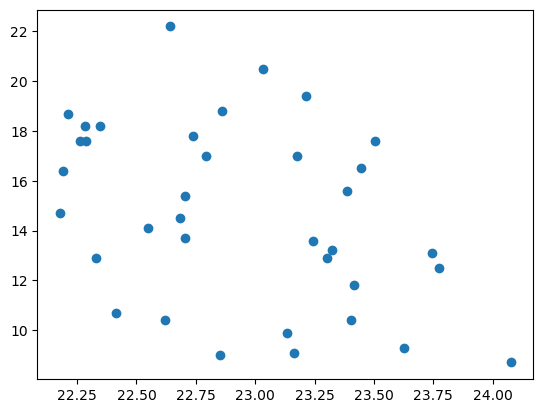

In [9]:
_ = plt.scatter(data['z'][0],data['z6'][0])

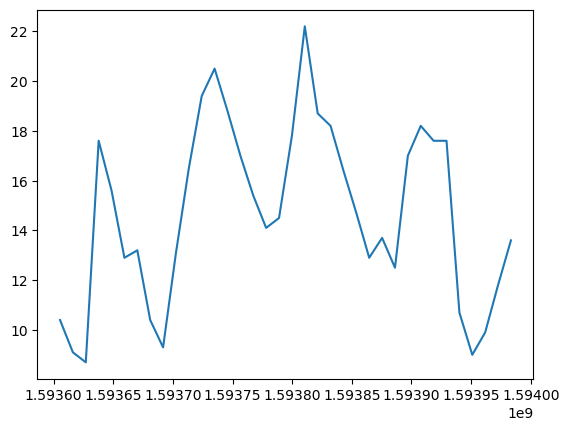

In [7]:
_ = plt.plot(data['x'],data['z6'][0])

In [14]:
data['z6'][0]

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 38,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 35.6,
 24,
 41.6,
 33.4,
 24.9,
 32.4,
 None,
 28.4,
 33.9,
 20.6,
 35.7]

In [18]:
z = []
z6 = []
files = glob.glob(r'./data/lakegreifenctdprofiles_datalakesdownload/*.json')
for file in files:
    with open(file) as f:
        data = json.load(f)
    z.extend(data['z'][0])
    z6.extend(data['z6'][0])
    #dates_string = file.split('_')[2]
    #dates.append(datetime.datetime.strptime(dates_string,'%Y-%m-%dT%H:%M:%S.%fZ'))
df_raw_0 = pd.DataFrame({'z':z,'z6':z6})

In [20]:
df_raw_0.replace("None",np.nan,inplace=True)

<Axes: >

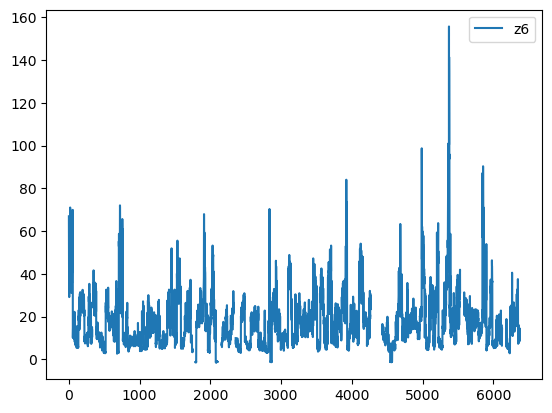

In [22]:
df_raw_0.plot.line(y="z6")

<Axes: xlabel='z', ylabel='z6'>

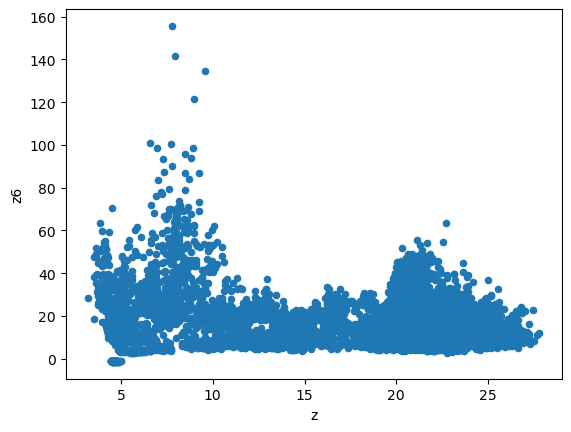

In [23]:
df_raw_0.plot.scatter(x="z",y="z6")

In [39]:
npz6 = np.array(data['z6'], dtype=np.float32)
npx = np.array(data['x'], dtype=np.float32)

In [38]:
npz6.shape

(161, 26)

In [44]:
np.nanmedian(npz6, axis=0)

array([10.1 , 10.4 ,  9.45, 11.7 , 10.9 , 10.9 , 10.3 , 11.7 , 11.6 ,
       11.9 , 10.85, 12.2 , 12.2 , 13.  , 13.2 , 12.9 , 11.5 , 14.  ,
       14.1 , 13.2 , 12.55, 14.5 , 13.4 , 14.55, 12.7 , 14.65],
      dtype=float32)

In [40]:
npx.shape

(26,)

In [43]:
np.median(npx)

1610636900.0

In [61]:
x = []
z = []
z1 = []
z2 = []
z3 = []
z4 = []
z5 = []
z6 = []
z7 = []
z8 = []
z9 = []
files = glob.glob(r'./data/lakegreifenctdprofiles_datalakesdownload/*.json')
for file in files:
    with open(file) as f:
        data = json.load(f)
    time = np.array(data['x'], dtype=np.float32)
    npz = np.array(data['z'], dtype=np.float32)
    npz1 = np.array(data['z1'], dtype=np.float32)
    npz2 = np.array(data['z2'], dtype=np.float32)
    npz3 = np.array(data['z3'], dtype=np.float32)
    npz4 = np.array(data['z4'], dtype=np.float32)
    npz5 = np.array(data['z5'], dtype=np.float32)
    npz6 = np.array(data['z6'], dtype=np.float32)
    npz7 = np.array(data['z7'], dtype=np.float32)
    npz8 = np.array(data['z8'], dtype=np.float32)
    npz9 = np.array(data['z9'], dtype=np.float32)
    x.extend(time.tolist())
    z.extend(np.nanmedian(npz, axis=0).tolist())
    z1.extend(np.nanmedian(npz1, axis=0).tolist())
    z2.extend(np.nanmedian(npz2, axis=0).tolist())
    z3.extend(np.nanmedian(npz3, axis=0).tolist())
    z4.extend(np.nanmedian(npz4, axis=0).tolist())
    z5.extend(np.nanmedian(npz5, axis=0).tolist())
    z6.extend(np.nanmedian(npz6, axis=0).tolist())
    z7.extend(np.nanmedian(npz7, axis=0).tolist())
    z8.extend(np.nanmedian(npz8, axis=0).tolist())
    z9.extend(np.nanmedian(npz9, axis=0).tolist())
    #dates_string = file.split('_')[2]
    #dates.append(datetime.datetime.strptime(dates_string,'%Y-%m-%dT%H:%M:%S.%fZ'))
df_raw = pd.DataFrame({"x":x,"z":z,"z1":z1,"z2":z2,"z3":z3,"z4":z4,"z5":z5,"z6":z6,"z7":z7,"z8":z8,"z9":z9})

In [62]:
df_raw.sort_values(by="x",inplace=True)

<Axes: xlabel='x'>

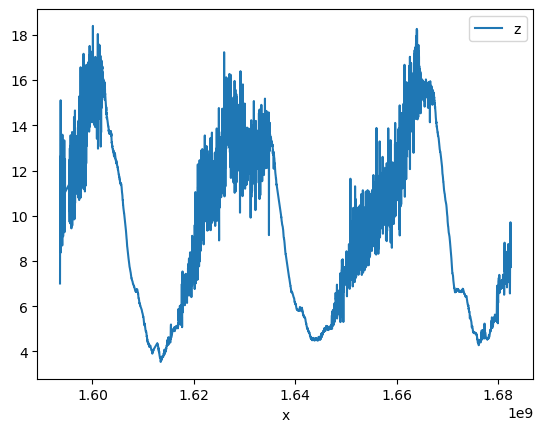

In [63]:
df_raw.plot.line(x="x",y="z")

<Axes: xlabel='x'>

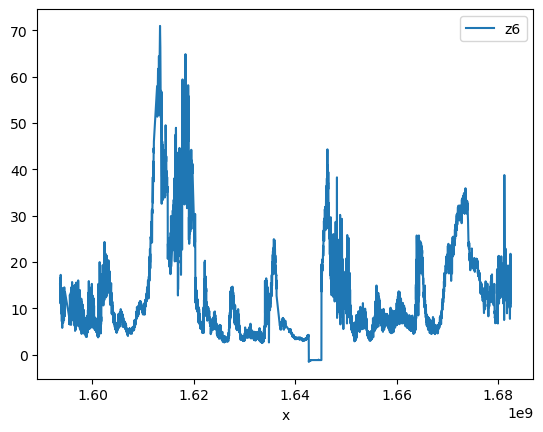

In [64]:
df_raw.plot.line(x="x",y="z6")

<Axes: xlabel='z6', ylabel='z8'>

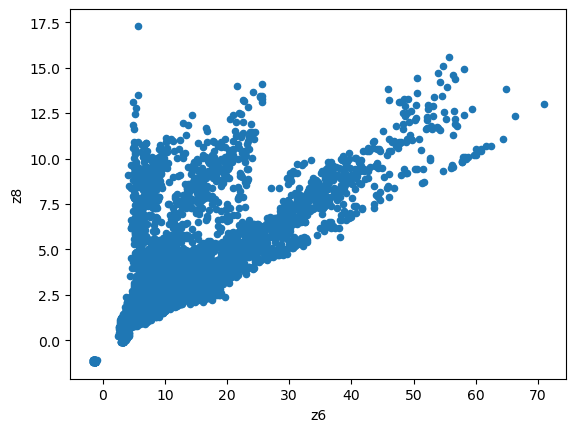

In [65]:
df_raw.plot.scatter(x="z6",y="z8")

<Axes: xlabel='z', ylabel='z8'>

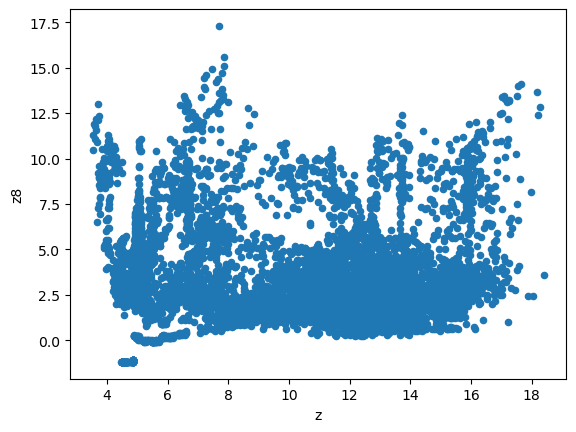

In [66]:
df_raw.plot.scatter(x="z",y="z8")

/tmp/ipykernel_831/3693436178.py:7: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


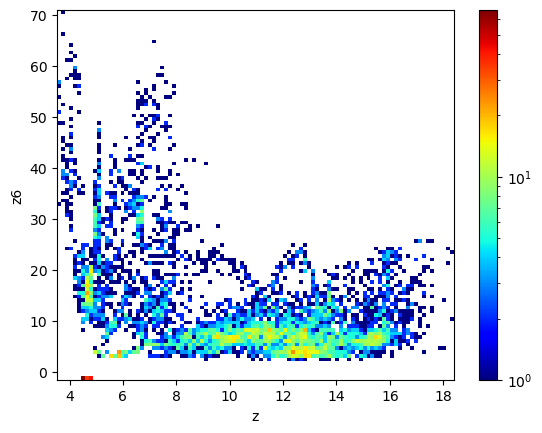

In [67]:
# 2D histogram of z and z6
fig, ax = plt.subplots()
hist = ax.hist2d(df_raw['z'], df_raw['z6'], bins=100, cmap=plt.cm.jet, norm=plt.cm.colors.LogNorm())
ax.set_xlabel('z')
ax.set_ylabel('z6')
fig.colorbar(hist[3], ax=ax)
fig.show()

/tmp/ipykernel_831/3954766019.py:6: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


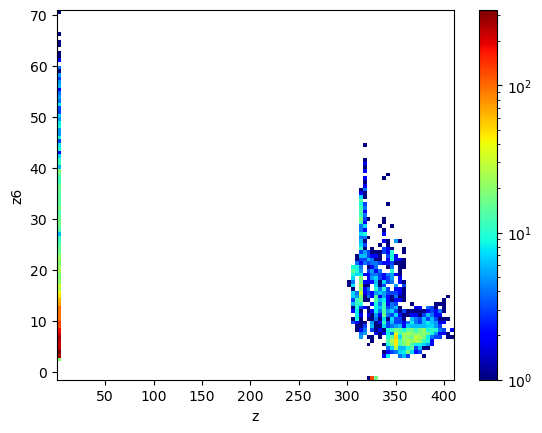

In [68]:
fig, ax = plt.subplots()
hist = ax.hist2d(df_raw['z1'], df_raw['z6'], bins=100, cmap=plt.cm.jet, norm=plt.cm.colors.LogNorm())
ax.set_xlabel('z')
ax.set_ylabel('z6')
fig.colorbar(hist[3], ax=ax)
fig.show()

/tmp/ipykernel_831/351943089.py:6: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


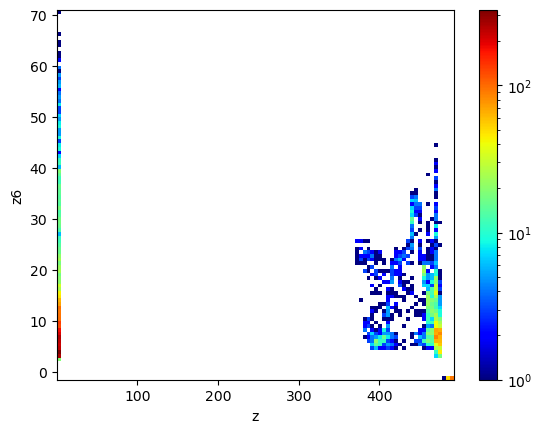

In [69]:
fig, ax = plt.subplots()
hist = ax.hist2d(df_raw['z2'], df_raw['z6'], bins=100, cmap=plt.cm.jet, norm=plt.cm.colors.LogNorm())
ax.set_xlabel('z')
ax.set_ylabel('z6')
fig.colorbar(hist[3], ax=ax)
fig.show()

/tmp/ipykernel_831/4168875196.py:6: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


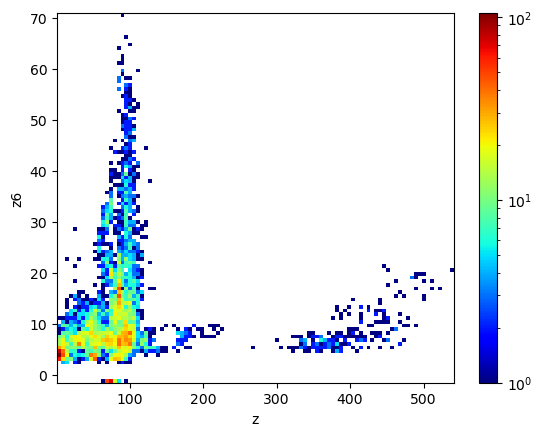

In [70]:
fig, ax = plt.subplots()
hist = ax.hist2d(df_raw['z3'], df_raw['z6'], bins=100, cmap=plt.cm.jet, norm=plt.cm.colors.LogNorm())
ax.set_xlabel('z')
ax.set_ylabel('z6')
fig.colorbar(hist[3], ax=ax)
fig.show()

/tmp/ipykernel_831/496418127.py:6: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


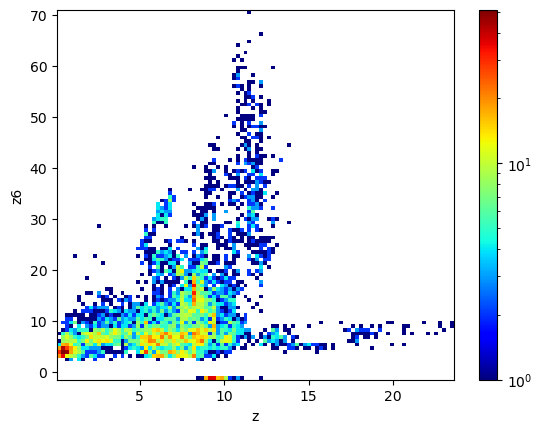

In [71]:
fig, ax = plt.subplots()
hist = ax.hist2d(df_raw['z4'], df_raw['z6'], bins=100, cmap=plt.cm.jet, norm=plt.cm.colors.LogNorm())
ax.set_xlabel('z')
ax.set_ylabel('z6')
fig.colorbar(hist[3], ax=ax)
fig.show()

/tmp/ipykernel_831/1966635186.py:6: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


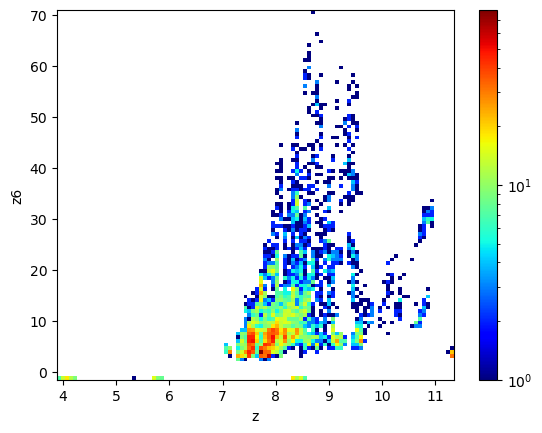

In [72]:
fig, ax = plt.subplots()
hist = ax.hist2d(df_raw['z5'], df_raw['z6'], bins=100, cmap=plt.cm.jet, norm=plt.cm.colors.LogNorm())
ax.set_xlabel('z')
ax.set_ylabel('z6')
fig.colorbar(hist[3], ax=ax)
fig.show()

/tmp/ipykernel_831/406205267.py:6: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


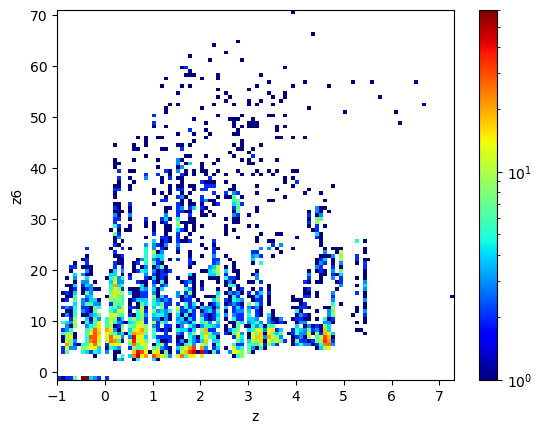

In [73]:
fig, ax = plt.subplots()
hist = ax.hist2d(df_raw['z7'], df_raw['z6'], bins=100, cmap=plt.cm.jet, norm=plt.cm.colors.LogNorm())
ax.set_xlabel('z')
ax.set_ylabel('z6')
fig.colorbar(hist[3], ax=ax)
fig.show()

/tmp/ipykernel_831/810805676.py:6: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


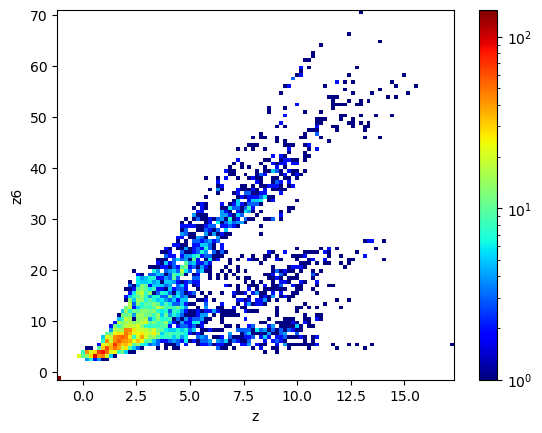

In [74]:
fig, ax = plt.subplots()
hist = ax.hist2d(df_raw['z8'], df_raw['z6'], bins=100, cmap=plt.cm.jet, norm=plt.cm.colors.LogNorm())
ax.set_xlabel('z')
ax.set_ylabel('z6')
fig.colorbar(hist[3], ax=ax)
fig.show()

/tmp/ipykernel_831/1011940425.py:6: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


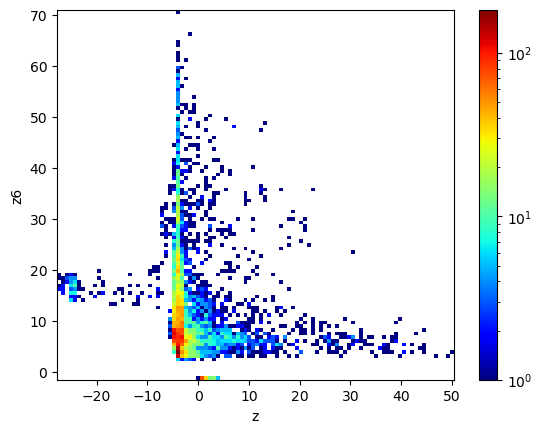

In [75]:
fig, ax = plt.subplots()
hist = ax.hist2d(df_raw['z9'], df_raw['z6'], bins=100, cmap=plt.cm.jet, norm=plt.cm.colors.LogNorm())
ax.set_xlabel('z')
ax.set_ylabel('z6')
fig.colorbar(hist[3], ax=ax)
fig.show()